<a href="https://colab.research.google.com/github/CChongQ/Digital-Systems---Project/blob/master/Assignment_5_handout.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Gradient-based Visualization of CNN Representations

**Assignment 5 - Fall 2020**  
_Univeristy of Toronto_


---



## (I) Introduction

While neural networks have shown impressive performance — with the notable example of computer vision tasks — their interpretability remains a concerning challenge. One of the most successful methods for understanding how neural networks build their "understanding" of a dataset is by _visualizing learned features using optimization_.

Generally, neural networks are differentiable with respect to their inputs [1]. Therefore, if we are interested in finding out what kind of input pattern(s) activate certain neurons, we can optimize the input to do so! This way, we can visualize the patterns that different layers of a trained model would find "interesting".

If you want to learn more, [[1]](https://distill.pub/2017/feature-visualization/) is a strongly recommended reading on this topic.




### This assignment

In this assignment, you will implement basic ideas of CNN feature visualization, using a pre-trained CNN architecture — VGG19.

We start off by loading and trimming the VGG model. Next, we build an optimization pipeline step by step in JAX. Building upon this, we will create a simple, but versatile, visualization class for VGG19 enabling us to easily perform experiments and plot visualizations of different layers, channels, and neurons in the model of interest.


### References
[1] [Olah, et al., "Feature Visualization", Distill, 2017.](https://distill.pub/2017/feature-visualization/)  
[2] [TensorFlow DeepDream Tutorial](https://www.tensorflow.org/tutorials/generative/deepdream)

---

## (II) Setting Up Local Dependencies

We use google drive to import local dependencies into the colab session. 📢 Running the following cell will create a folder named `ECE421_FeatureVis` in the root directory of your google drive, and downloads the needed files. Make sure to have at least 600 MBs of available space in the Gdrive you select. (You can always create a new account!)

You can access a file browser for this colab session, by clicking the _folder_ icon from the left panel. The current directory, where this notebook is located, is at `/content`. (You can print the present working directory by running `!pwd`.)

 Once the cell finished running, you should be able to see `utils.py` and `objax/zoo/pretrained/vgg19.npy` added to the current directory. 

In [1]:
from pathlib import Path
gdrive_path = Path('./drive')
gdrive_asn_dir = 'ECE421_FeatureVis'

# mount your google drive to colab session
import os
from google.colab import drive
drive.mount(gdrive_path.as_posix())
gdrive_path  /= 'My Drive'

# create a directory in gdrive to download local dependencies
os.makedirs(gdrive_path/gdrive_asn_dir, exist_ok=True)

# download local dependencies
import gdown
vgg_path = gdrive_path / gdrive_asn_dir / 'vgg19.npy'
utils_path = Path('./utils.py')
if not vgg_path.exists():
  vgg19_gdrive_id = '1eAiFwI4fYsl3nRyLAOLBgu0YEvQ45exh'
  url = f'https://drive.google.com/uc?id={vgg19_gdrive_id}'
  gdown.download(url, vgg_path.as_posix(), quiet=False)
if not utils_path.exists():
  utils_url = 'https://github.com/mamaj/cnn-featurevis-ece421/raw/master/utils.py'
  gdown.download(utils_url, utils_path.as_posix(), quiet=False)

# copy dependencies from gdrive into the colab session
from shutil import copyfile
os.makedirs('./objax/zoo/pretrained', exist_ok=True)
copyfile(vgg_path, "./objax/zoo/pretrained/vgg19.npy")

# unmount gdrive
drive.flush_and_unmount()

Mounted at drive


In [2]:
!pip install --quiet --upgrade objax

# This makes JAX allocate exactly what is needed on demand, and deallocate 
# memory that is no longer needed. More info:
# https://jax.readthedocs.io/en/latest/gpu_memory_allocation.html
os.environ['XLA_PYTHON_CLIENT_ALLOCATOR'] = 'platform' 

In [3]:
from functools import partial

import numpy as np
import jax
import jax.numpy as jnp
from jax import grad, jit, random
import objax
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm, trange

from utils import imshow, interct_imshow
import utils

# (1) The CNN Model: VGG19

[VGG19 architecture](https://arxiv.org/abs/1409.1556) consists of 16 consecutive 3$\times$3 convolution layers with max poolings in between, followed by 3 fully connected layers. We are interested in examining input patterns that excite the neurons in different convolutional layers. 

<figure>
<img src="https://raw.githubusercontent.com/mamaj/cnn-featurevis-ece421/master/figs/vgg19_2.png"
     alt="VGG19 architecture"
     style="float: left; margin-right: 5px;"
     height="300px" />
<figcaption>VGG19 architecture</figcaption>

</figure>

We can import a VGG19 model, pretrained on [ImageNet dataset](http://www.image-net.org/), using Objax. [`objax.zoo` package](https://objax.readthedocs.io/en/latest/objax/zoo.html) contains implementations for a handful of famous networks. 


The following cell loads a pretrained `VGG19` object as a subclass of [`objax.nn.Sequential`](https://objax.readthedocs.io/en/latest/objax/nn.html#objax.nn.Sequential) class. An objax `Sequential` object can be thought of as a `list` of different [modules](https://objax.readthedocs.io/en/latest/advanced/variables_and_modules.html#module) (e.g. convolution layers, ReLU activations, poolings, etc.), where each module can be accessed like regular `list` elements. In addition, calling a `Sequential` object with any input executes its modules in order.

In [4]:
from objax.zoo import vgg
model = vgg.VGG19(pretrained=True)

Objax VGG19 model accepts inputs as a batch of images in _Channels-First_ format: `(batch, channel, height, width)`, with pixel values in the range of [0 ... 255]. Note that matplotlib and `IPython.Display` modules accept images in _Channels-Last_ format: `(height, width, channel)`.
You may use `imshow()` and `interact_imshow()` helper functions from `utils.py` for plotting images, which also take care of the channel ordering conversions. 

`utils.get_vgg19_layer_names` returns a list of the names of every layer in VGG19. Let us print the index, name, and input/output depth/size of each layer in this model.

In [5]:
layer_names = utils.get_vgg19_layer_names(model)

# print index, name, input -> output depth/size for each NN layer in `model`.
for i, name in enumerate(layer_names):
  if isinstance(model[i], (objax.nn.Conv2D, objax.nn.Linear)):
    in_shape, out_shape = model[i].w.value.shape[-2:]
    print(f'{i} \t {name}    \t {in_shape} \t -> \t {out_shape}')
  else:
    print(f'{i} \t {name}')

0 	 conv1_1    	 3 	 -> 	 64
1 	 relu1_1
2 	 conv1_2    	 64 	 -> 	 64
3 	 relu1_2
4 	 pool1
5 	 conv2_1    	 64 	 -> 	 128
6 	 relu2_1
7 	 conv2_2    	 128 	 -> 	 128
8 	 relu2_2
9 	 pool2
10 	 conv3_1    	 128 	 -> 	 256
11 	 relu3_1
12 	 conv3_2    	 256 	 -> 	 256
13 	 relu3_2
14 	 conv3_3    	 256 	 -> 	 256
15 	 relu3_3
16 	 conv3_4    	 256 	 -> 	 256
17 	 relu3_4
18 	 pool3
19 	 conv4_1    	 256 	 -> 	 512
20 	 relu4_1
21 	 conv4_2    	 512 	 -> 	 512
22 	 relu4_2
23 	 conv4_3    	 512 	 -> 	 512
24 	 relu4_3
25 	 conv4_4    	 512 	 -> 	 512
26 	 relu4_4
27 	 pool4
28 	 conv5_1    	 512 	 -> 	 512
29 	 relu5_1
30 	 conv5_2    	 512 	 -> 	 512
31 	 relu5_2
32 	 conv5_3    	 512 	 -> 	 512
33 	 relu5_3
34 	 conv5_4    	 512 	 -> 	 512
35 	 relu5_4
36 	 pool5
37 	 flatten
38 	 fc6    	 25088 	 -> 	 4096
39 	 relu6
40 	 fc7    	 4096 	 -> 	 4096
41 	 relu7
42 	 fc8    	 4096 	 -> 	 1000


Since we are only interested in convolutional layers, we need to first chop off the last three fully connected layers. This will also let us input images with arbitrary sizes to the model:

> By design, the inputs to the VGG model should be images of size 224$\times$224 pixels. This limit is imposed by fixed sizes of the last fully connected layers.  Without them, images with arbitrary sizes can be processed in the convolutional layers, since the output of each layer will scale according to the input size.

​<font color='green'>
👨‍💻 (2/30) 
</font>
1.1. Find the index of the "flatten" layer in `model`, and instantiate a new `objax.nn.Sequential` model using only the layers before the flatten.  


In [6]:
flatten_idx = None 

# TODO: 
# Find the index of the "flatten" layer in model, assign it to `flatten_idx` and
# instantiate a new objax.nn.Sequential model using only the layers before the 
# flatten.
for i, name in enumerate(layer_names):
  if name == 'flatten':
    flatten_idx = i
    break;

layer_names = layer_names[:flatten_idx]
new_model = objax.nn.Sequential()
new_model = model[:flatten_idx]

In [ ]:
new_model

 <function objax.functional.core.activation.relu>,
 <function objax.functional.core.activation.relu>,
 <function objax.zoo.vgg.max_pool_2d>,
 <function objax.functional.core.activation.relu>,
 <function objax.functional.core.activation.relu>,
 <function objax.zoo.vgg.max_pool_2d>,
 <function objax.functional.core.activation.relu>,
 <function objax.functional.core.activation.relu>,
 <function objax.functional.core.activation.relu>,
 <function objax.functional.core.activation.relu>,
 <function objax.zoo.vgg.max_pool_2d>,
 <function objax.functional.core.activation.relu>,
 <function objax.functional.core.activation.relu>,
 <function objax.functional.core.activation.relu>,
 <function objax.functional.core.activation.relu>,
 <function objax.zoo.vgg.max_pool_2d>,
 <function objax.functional.core.activation.relu>,
 <function objax.functional.core.activation.relu>,
 <function objax.functional.core.activation.relu>,
 <function objax.functional.core.activation.relu>,
 <function objax.zoo.vgg.max

# (2) Hands-on
In this section, we perform *gradient ascent* on an input image to *maximize* the mean activation of the last layer neurons.

> Similar to the idea of gradient descent—where in order to minimize an objective function, we take steps proportional to the negative of its gradient at the current point—with gradient *ascent*, we iteratively maximize the value of an objective function by taking steps *towards* the direction of its gradient, at each point.

​<font color="green">
👨‍💻 (1/30)
</font> 
2.1. Implement the loss function below to return the mean activation of the last layer of its `model` argument given an input image `x`.

In [ ]:
def loss(model, x):
  # TODO: return the mean activation of the last layer of `model` given the input `x`
  output = model(x)
  result = np.mean(output) # To check
  # print('result = ',result)
  return result


​<font color="green">
👨‍💻 (3/30)
</font> 2.2. Update image `x` by applying **one** step of gradient ascent.

Notes:
* Use JAX's `grad` method to find the gradient of the loss w.r.t the input image.
* Clip the updated image to have values in the range [0...255]. You may find `jnp.clip()` very helpful.
* To have easier step size tuning, normalize the gradient values to have unit variance.

In [ ]:
@jit
def update_input(x, step_size=1.):

  # TODO: update image x by applying one step of gradient ascent.
  grad_loss_x = grad(loss,argnums=1)(new_model,x) # differentiate with respect to x

  #normalization
  S = np.std(grad_loss_x)
  grad_norm = grad_loss_x/ S

  next = x + grad_norm*step_size
 
  #clip
  x = jnp.clip(next,0,255)

  return x

​<font color="green">
👨‍💻 (2/30)
</font> 
2.3. Perform `steps` iterations of gradient ascent using `update_input()` method you implemented above. Keep track of each updated input and return them in a list as an output.  

Tip: use `trange` instead of `range` in your for-loop to plot a progress bar of your loop executions. (This is, truly, maximal utility by minimal intervention 👍) 

In [ ]:
def visualize(x, steps=150, step_size=1.):
  img_list = [x]
  
  # TODO: Perform `steps` iterations of gradient ascent update using update_input()
  for eachStep in trange(steps):
    x_update = update_input(x,step_size)
    img_list.append(x_update)
    x = x_update

  return x, img_list

​<font color="green">
👨‍💻 (2/30)
</font>
2.4. Generate a random input image, such that every pixel's red, green, or blue element is turned on (=255) with probability 0.001, and is turned off (=0) with probability 0.999, independently. Do not forget to include the leading batch dimension.

A sample image should look almost black with sporadic red, green, and blue pixels. You may use random modules from either JAX or NumPy. You can also use `imshow()` from `utils.py` to plot a single image in this assignment. 

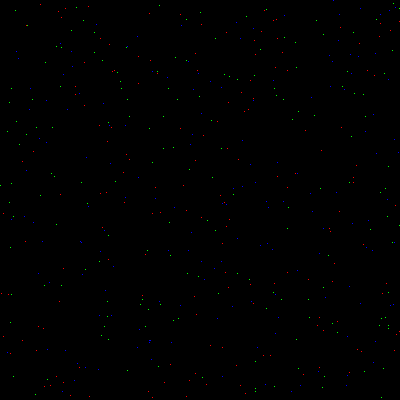

In [ ]:
def random_image(key, size=(300, 300), p=0.001):

  # TODO: Generate a random image with [height, width = `size`], as explained above.
  num_channel = 3;
  on_off = np.array([0.0,255.0])
  p =  np.array([1-p,p]) # 0: 0.999, 255: 0.001
  shape =  (1,num_channel,size[0],size[1])
  x =  random.choice(key=key,a=on_off,shape=shape,replace=True,p=p)
  
  return x

key = jax.random.PRNGKey(0) #Create a pseudo-random number generator (PRNG) key given an integer.
x = random_image(key, size=(400, 400), p=0.001)
imshow(x)

Let's run them all! 

We can use `interct_imshow()` to explore the evolution of the input image throughout the optimization. 

Spoiler Alert: You may be able to recognize some (dreamy/hallucinated) animal faces in the final result.

In [ ]:
x_hat, img_list = visualize(x, steps=300, step_size=1.)
interct_imshow(img_list)

interactive(children=(IntSlider(value=300, description='idx', max=300), Output()), _dom_classes=('widget-inter…

### Taking it up an octave <sup><sub>[from [2]](https://www.tensorflow.org/tutorials/generative/deepdream#taking_it_up_an_octave)</sub></sup>

Pretty good, but there are a few issues with this first attempt:

* The output is noisy.
* The image is low resolution.
* The patterns appear like they're all happening at the same granularity.

One approach that addresses all these problems is applying gradient ascent at different scales. This will allow patterns generated at smaller scales to be incorporated into patterns at higher scales and filled in with additional detail.

To do this you can perform the previous gradient ascent approach, then increase the size of the image (which is referred to as an _octave_), and repeat this process for multiple octaves.




**​**<font color="green">
👨‍💻 (3/30)
</font> 2.5. Complete the implementation of `visualize_octave()` as follows:

For each octave `n` in `oct_range`, you need to:
* First, resize the optimized image of the previous step to  `base_shape * (oct_scale ** n)`, where  `base_shape` is the shape of the original input image.
* Then, apply another round of optimization updates using the `visualize()` method.


Notes:
* Keep track of each updated input and return them in a list as an output.  
* You may also use [`jax.image.resize()`](https://jax.readthedocs.io/en/latest/_autosummary/jax.image.resize.html) for scaling the input image. 

In [ ]:
def visualize_octave(x, oct_range=range(-2, 3), oct_scale=1.8, steps_per_oct=100, step_size=1.):
  img_list = []

  # TODO: Complete the implementation as instructed above.
  base_shape = x.shape[-2:] #height, width

  for n in oct_range:
    new_hw = [ round(each * (oct_scale ** n)) for each in base_shape] #new size
    new_shape = [x.shape[0], x.shape[1]] + new_hw 
    x_resize = jax.image.resize(x,new_shape,"nearest") #scaling the image
    x_hat, img_list_temp = visualize(x_resize, steps=steps_per_oct, step_size=step_size)
    
    x = x_hat
    img_list.extend(img_list_temp)
  
  return x_hat, img_list

Now, run the optimization using the octave scaling trick and plot the result. Much better!

In [ ]:
x = random_image(key, size=(200, 200), p=0.001)

x_hat, img_list = visualize_octave(x)
interct_imshow(img_list)

base_shape =  (200, 200)
new_shape =  [1, 3, 62, 62]



base_shape =  (200, 200)
new_shape =  [1, 3, 111, 111]



base_shape =  (200, 200)
new_shape =  [1, 3, 200, 200]



base_shape =  (200, 200)
new_shape =  [1, 3, 360, 360]



base_shape =  (200, 200)
new_shape =  [1, 3, 648, 648]


interactive(children=(IntSlider(value=504, description='idx', max=504), Output()), _dom_classes=('widget-inter…

# (3) Visualizer Class

In this section, we package all the methods we implemented so far into a class. In addition, we are going to add another functionality: selecting wich layers, which channels in a layer, or which neurons of a channel to maximize:

<figure>
  <img src="https://raw.githubusercontent.com/mamaj/cnn-featurevis-ece421/master/figs/opt_objective.png"
      alt="Different optimization objectives"
      style="float: left; margin-right: 5px;"
      height="300px"/>
  <figcaption>Different optimization objectives show what different parts of a network are looking for. Taken from [1].</figcaption>
</figure>

In order to do so, we need to take control of the forward pass calculation of the model, and keep references of intermediate activations of interest (neurons, channels, or layers). We can also use the mean activation of _multiple_ layers as objective.


​<font color="green">
👨‍💻 (5/30)
</font> 3.1. Use the methods you implemented in the previous section to complete the definition of the class below.

Note that we use the new `forward_path` method in the `loss` function.

In [7]:
class FeatureVis(objax.Module):
  
  def __init__(self, base_model, layers, channels=None, neurons=None):
    '''
    layers : list of ints
      the index of layers to select from base_model.

    channels: None or a list of ints with the same length as `layers`.
      if None, selects all channels, otherwise, select channels[i] for layers[i]. 
    
    neurons: None or a list of 2d tuples with the same length as `layers`.
      if None, selects all neurons, otherwise, select neurons[i] for layers[i].
    '''
    if isinstance(layers, int):
      layers = [layers]
    if channels is None:
      channels = [slice(None)] * len(layers)
    if neurons is None:
      neurons = [(slice(None), slice(None))] * len(layers)
    
    self.layers = layers
    self.channels = channels
    self.neurons = neurons
    self.model = base_model
    super().__init__()
  
  def forward_pass(self, x):
    activations = []
    for i, layer in enumerate(self.model):
      x = layer(x)
      if i in self.layers:
        c = self.channels[self.layers.index(i)]
        n = self.neurons[self.layers.index(i)]
        activations.append(x[:, c, n[0], n[1]])
      if len(activations) == len(self.layers):
        break
    return activations

  def loss(self, x):
    activations = self.forward_pass(x)
    return jnp.sum(jnp.array([a.mean() for a in activations]))

  @partial(jit, static_argnums=(0,))
  def update_input(self, x, step_size):

    # TODO: complete similar to `update_input` method from the previous section.

    grad_loss_x = grad(self.loss)(x) 

    #normalization
    S = np.std(grad_loss_x) + 1e-8
    grad_norm = grad_loss_x/ S

    next = x + grad_norm*step_size
  
    #clip
    x = jnp.clip(next,0,255)

    return x

  def __call__(self, x, steps=150, step_size=1.):

    # TODO: complete similar to `visualize` method from the previous section.
    for eachStep in trange(steps):
      x_update = self.update_input(x,step_size)
      x = x_update

    return x


  def vis_octave(self, x, oct_range=range(-2, 3), oct_scale=1.8, steps_per_oct=100, step_size=1.):

    # TODO: complete similar to `visualize_octave` method from the previous section.
    
    base_shape = x.shape[-2:] #height, width

    for n in oct_range:
      new_hw = [ round(each * (oct_scale ** n)) for each in base_shape] #resize
      new_shape = [x.shape[0], x.shape[1]] + new_hw 
      x_resize = jax.image.resize(x,new_shape,"nearest") #scaling the image
      x_hat = self(x_resize, steps=steps_per_oct, step_size=step_size) 
      x = x_hat
 
    return x

​<font color="green">
👨‍💻 (4/30)
</font> 3.2. Run the visualization using `FeatureVis` class for channel 1 of _all_ convolutional layers in VGG19.

Notes:   
* As you may have already noticed, Objax implementation of a neural network "layer" only contains weight matrix multiplication (or convolution operation), and activation functions are applied separately following the layers, whereas in the class we treated a layer as the weight matrix multiplication + activation.   
Therefore, when initializing `FeatureVis` objects, be careful to select `layers` corresponding to ReLU activation functions.

* You should keep the optimized image for each layer in `results` list, and the name of each layer in `names` list.
* To optimize for each layer, you need to instantiate a new `FeatureVis` object with a different layer as its constructor argument. Do _not_ manually change `FeatureVis.layers`.

In [ ]:
results = []
names = []

size = (100, 100)
steps_per_oct = 100
channel = 1

input_img = random_image(key, size=size, p=0.001)

results.append(input_img)
names.append('input')

# TODO: Run the visualization using `FeatureVis` class for channel 1 of 
# _all_ CNN layers in VGG19.
layer_names = utils.get_vgg19_layer_names(model)
layer_index_relu = []
for i, name in enumerate(layer_names): 
  if i == flatten_idx:
    break;
  elif 'relu' in name:
    names.append(name)
    layer_index_relu.append(i)

# print(layer_index_relu)

for each in layer_index_relu:
  temp = FeatureVis(new_model,each,channels=[channel])
  vis_octave_out = temp.vis_octave(input_img,steps_per_oct=steps_per_oct)
  results.append(vis_octave_out)

from IPython import display
display.clear_output()

The following cell will plot the optimized images for each layer:

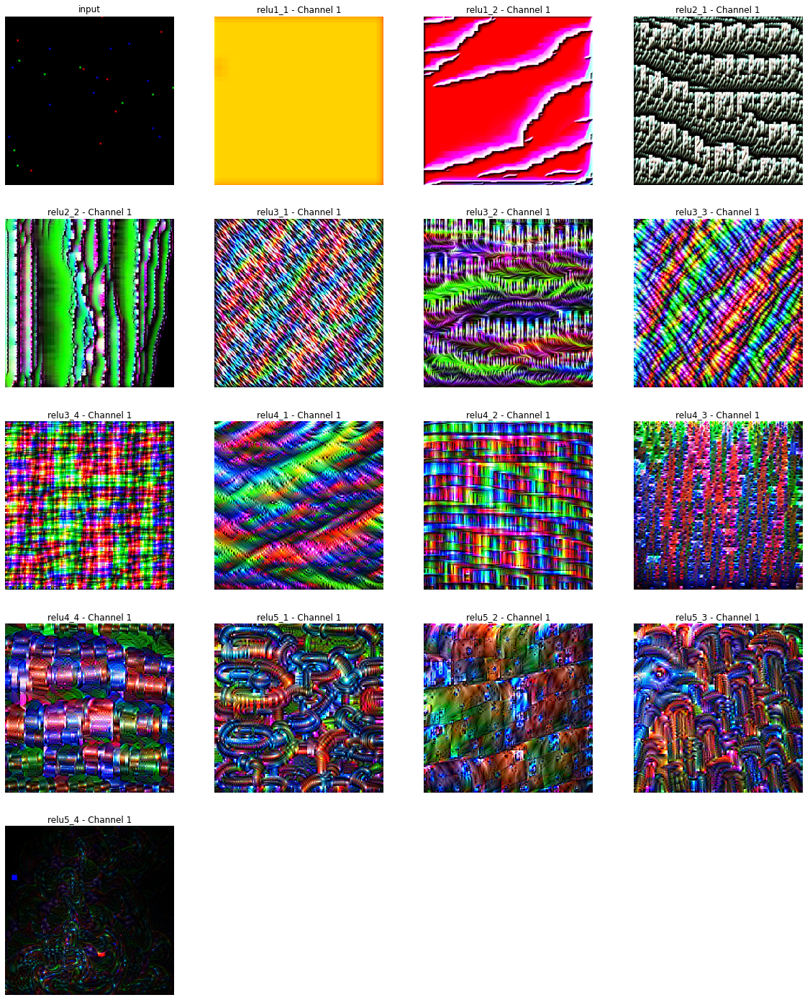

In [ ]:
from objax.util.image import nhwc
from math import ceil

n_cols = 4
n_rows = ceil(len(results) / n_cols)
ax_size = 5
fig, axs = plt.subplots(n_rows, n_cols, figsize=(ax_size*n_cols, ax_size*n_rows))
for ax in axs.flat: ax.set_axis_off()
for name, ax, x in zip(names, axs.flat, results):
  ax.imshow(nhwc(x)[0].astype(np.uint8))
  ax.set_title(f'{name} - Channel {channel}')
axs[0, 0].set_title('input');

​<font color="green">
👨‍💻 (2/30)
</font> 3.3. How do you compare the visualizations obtained for the first-level convolutions versus deeper layers? Based on this observation, what can you conclude about the hierarchy of pattern recognition in a CNN?

In [ ]:
#@markdown 📝Write down your answer here:
answer_3_3 = "In the first-level convolutions, the patterns are simple and the colors are more monotonous. The visualization of deeper layers is more complex and colorful, we start to observe patterns that are not just straight lines. For instance, the pattern of relu5_1 layer looks like chains, the pattern of relu5-3 layer looks like an animal face.  In conclusion, the deeper we go, the more intermediate neurons got excited, the clearer, complex and abstract pattern we can identify . " #@param {type:"string"}

## CNN Receptive Field


​<font color="green">
👨‍💻 (2/30)
</font>
3.4. Perform the visualization procedure (without octave scaling) to maximize the activation of neurons in coordinate (5, 5) over all channels for a shallow layer (`relu2_2`) and a deep layer (`relu5_4`).

In [ ]:
x = random_image(key, size=(300, 300), p=0.001)

results = [x]
names_2 = ['input','relu2_2','relu5_4']

# TODO: Visualize features of neuron (5, 5) in layer `relu2_2`
r22_index = layer_index_relu[names.index('relu2_2')-1]
temp_1 = FeatureVis(new_model,r22_index,neurons=[(5,5)]) #neurons=(5,5), all channels
temp_1_result = temp_1(x)
results.append(temp_1_result)

# TODO: Visualize features of neuron (5, 5) in layer `relu5_4`
r54_index = layer_index_relu[names.index('relu5_4')-1]
temp_2 = FeatureVis(new_model,r54_index,neurons=[(5,5)]) #neurons=(5,5), all channels
temp_2_result = temp_2(x)
results.append(temp_2_result)

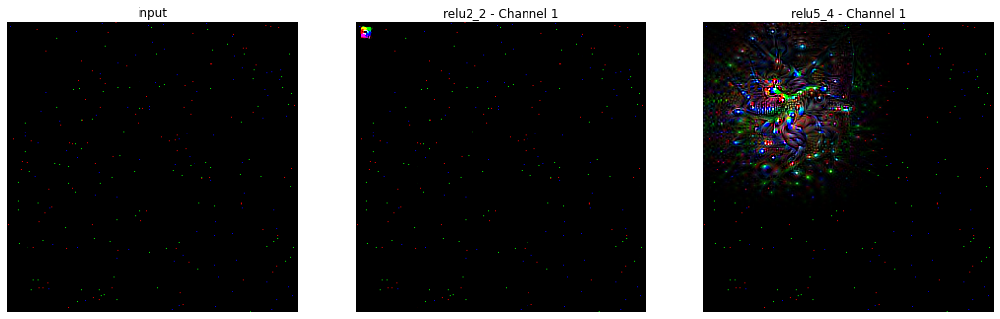

In [ ]:
n_cols = 3
n_rows = ceil(len(results) / n_cols)
ax_size = 6
fig, axs = plt.subplots(n_rows, n_cols, figsize=(ax_size*n_cols, ax_size*n_rows))
for ax in axs.flat: ax.set_axis_off()

for name, ax, x in zip(names_2, axs.flat, results):
  ax.imshow(nhwc(x)[0].astype(np.uint8))
  ax.set_title(f'{name} - Channel {channel}')
axs[0].set_title('input');

​<font color="green">
👨‍💻 (2/30)
</font> 3.5. Justify the difference you observe between the visualizations of neurons in the two layers. More specifically, why do you see a wider area affected by the deeper neurons?

In [ ]:
#@markdown 📝Write down your answer here:
answer_3_5 = "In the shallow layer, a smaller region of neurons is activated, affected area are smaller and the pattern are more concentrated. The deeper layer has a larger affected area, so colors are more separated compared to the shallow layer, the pattern shape is more abstract.  The reason could be that the deeper layers represent larger areas of the input, their neurons become more specialized, so the activation area is larger and the pattern shape is more complex." #@param {type:"string"}

# (4) The Art: Deep Dream


Besides bringing insights into how CNNs build up their "understanding" of images from the dataset they are trained on, as you might have wondered, the generated images are stunning! 

We can apply this dream-like effect to an image by using it as the starting point of the optimization. As you may already know, this is called "deep dream". If you are interested, watch this amazing [video](https://youtu.be/SCE-QeDfXtA), and see [here](https://deepdreamgenerator.com/) for an online deep dream tool.

​<font color="green">
👨‍💻 (2/30)
</font> 4.1. Apply the Deep Dream effect on an image of your choice. You can control the selection of layers, channels, and neurons as well as octave scaling parameters and the number of gradient ascent steps to design your final output. 

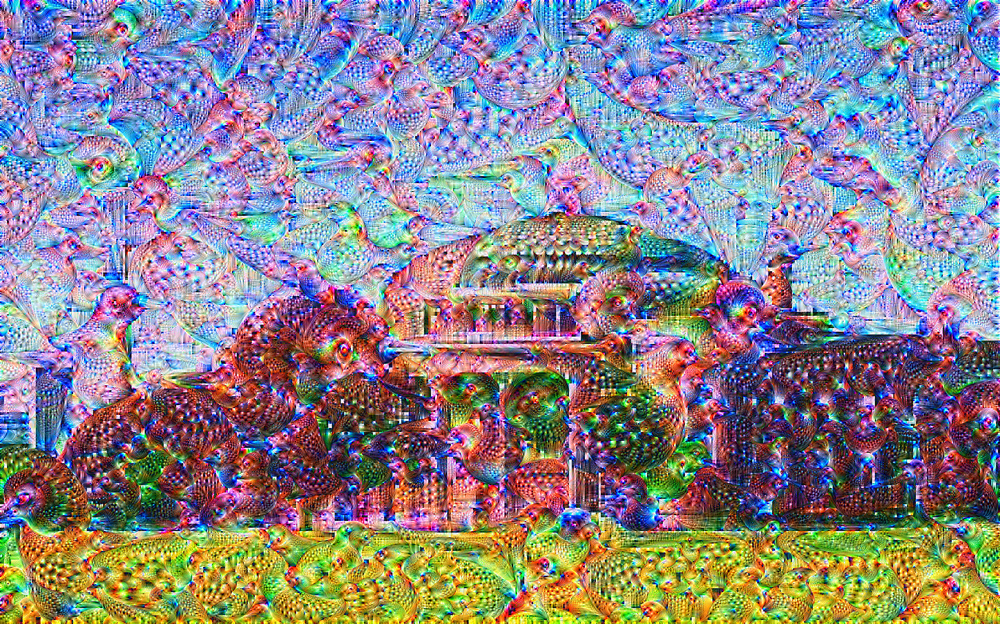

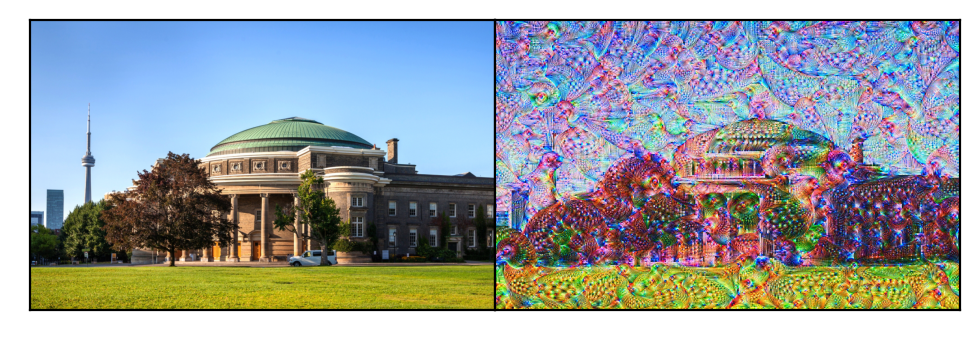

In [8]:
url = 'https://static.timesofisrael.com/blogs/uploads/2019/11/Optimized-ConvocationHall-uoft-cntower.jpg'

input_img = utils.get_image(url)
input_img = input_img[np.newaxis, ...]


# TODO: 
# update `input_img` to maximize activations of your selected layers. 
# assign output to `dream_img` variable
# Deeper layers will result in cooler outputs!
input_img = input_img[:,:,:,:].astype(float)
temp_4 = FeatureVis(new_model,33) #layer:relu5_3, all channels, all neurons 
temp_4_octave_out = temp_4.vis_octave(input_img, oct_scale=1.8,steps_per_oct= 80,step_size=1.2)
dream_img = temp_4_octave_out


fig, axs = plt.subplots(1, 2, dpi=200)
fig.subplots_adjust(wspace=0, hspace=0)
for x, ax in zip((input_img, dream_img), axs.flat):
  x = np.transpose(x[0], (1, 2, 0)).astype(np.uint8)
  ax.imshow(x)
  ax.set_xticks([])
  ax.set_yticks([])

imshow(dream_img)